# EDA of Single Family Loan-Level Data for the year 2007, 2008 and 2009

**Importing dependencies**

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import seaborn as sns
import cufflinks as cf
import plotly.graph_objs as go
import plotly.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from datetime import datetime as dt
import calendar as cal

init_notebook_mode(connected=True)
cf.go_offline()

from IPython.core.display import HTML
%matplotlib inline

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


**Load the sample data after web scrapping into dataframes**

In [5]:
df = pd.read_csv('Sample Origination Combined.csv', low_memory=False)
pf = pd.read_csv('Sample Performance Combined Summary.csv', low_memory=False)

In [6]:
df.count()

fico              637500
dt_first_pi       637500
flag_fthb         637500
dt_matr           637500
cd_msa            637500
mi_pct            637500
cnt_units         637500
occpy_sts         637500
cltv              637500
dti               637500
orig_upb          637500
ltv               637500
int_rt            637500
channel           637500
ppmt_pnlty        637500
prod_type         637500
st                637500
prop_type         637500
zipcode           637500
id_loan           637500
loan_purpose      637500
orig_loan_term    637500
cnt_borr          637500
seller_name       637500
servicer_name     637500
flag_sc           637500
Year              637500
dtype: int64

In [7]:
pf.count()

loan_seq                 637441
max_current_upb          637441
min_current_upb          637441
max_delq_sts             637441
min_delq_sts             637441
max_cd_zero_bal          637441
min_cd_zero_bal          637441
max_non_mi_recoveries    637441
min_non_mi_recoveries    637441
max_expenses             637441
min_expenses             637441
max_legal_costs          637441
min_legal_costs          637441
max_maint_pres_costs     637441
min_maint_pres_costs     637441
max_taxes_ins_costs      637441
min_taxes_ins_costs      637441
max_misc_costs           637441
min_misc_costs           637441
max_actual_loss          637441
min_actual_loss          637441
max_modcost              637441
min_modcost              637441
dtype: int64

In [8]:
df.head(3).transpose()

,0,1,2
fico,722,759,591
dt_first_pi,200504,200503,200504
flag_fthb,N,N,N
dt_matr,203503,203502,203503
cd_msa,0,0,39100
mi_pct,0,0,0
cnt_units,1,1,1
occpy_sts,P,P,P
cltv,80,25,48
dti,48,25,34


In [9]:
pf.head(3).transpose()

,0,1,2
loan_seq,F105Q1000064,F105Q1000076,F105Q1000087
max_current_upb,62000,197000,100000
min_current_upb,0,0,0
max_delq_sts,0,0,1
min_delq_sts,0,0,0
max_cd_zero_bal,1,1,1
min_cd_zero_bal,-1,-1,-1
max_non_mi_recoveries,0,0,0
min_non_mi_recoveries,0,0,0
max_expenses,0,0,0


**Merging the two datasets**

In [10]:
joined_df = pd.DataFrame()
joined_df = pd.merge(df, pf, left_on = 'id_loan',right_on='loan_seq',how='inner')
joined_df

,fico,dt_first_pi,flag_fthb,dt_matr,cd_msa,mi_pct,cnt_units,occpy_sts,cltv,dti,...,max_maint_pres_costs,min_maint_pres_costs,max_taxes_ins_costs,min_taxes_ins_costs,max_misc_costs,min_misc_costs,max_actual_loss,min_actual_loss,max_modcost,min_modcost
0,722,200504,N,203503,0,0,1,P,80,48,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
1,759,200503,N,203502,0,0,1,P,25,25,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2,591,200504,N,203503,39100,0,1,P,48,34,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
3,792,200503,N,203502,39100,0,1,P,90,33,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
4,725,200503,N,203502,48864,0,1,P,49,41,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
5,788,200503,N,203502,0,0,1,P,75,55,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
6,691,200503,N,203502,0,35,1,P,97,48,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3508.939941,0.0
7,687,200503,N,203502,0,0,1,P,40,46,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
8,784,200503,N,203502,0,0,1,P,35,30,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
9,703,200503,N,203502,0,0,1,P,67,53,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0


In [11]:
joined_df.count()

fico                     637441
dt_first_pi              637441
flag_fthb                637441
dt_matr                  637441
cd_msa                   637441
mi_pct                   637441
cnt_units                637441
occpy_sts                637441
cltv                     637441
dti                      637441
orig_upb                 637441
ltv                      637441
int_rt                   637441
channel                  637441
ppmt_pnlty               637441
prod_type                637441
st                       637441
prop_type                637441
zipcode                  637441
id_loan                  637441
loan_purpose             637441
orig_loan_term           637441
cnt_borr                 637441
seller_name              637441
servicer_name            637441
flag_sc                  637441
Year                     637441
loan_seq                 637441
max_current_upb          637441
min_current_upb          637441
max_delq_sts             637441
min_delq

In [12]:
joined_df['id_loan'].unique()

array(['F105Q1000064', 'F105Q1000076', 'F105Q1000087', ..., 'F117Q3347672',
       'F117Q3347689', 'F117Q3347731'], dtype=object)

In [13]:
df_2007 = joined_df[(joined_df['Year'] == 2007)]
df_2008 = joined_df[(joined_df['Year'] == 2008)]
df_2009 = joined_df[(joined_df['Year'] == 2009)]

df_789 = pd.concat([df_2007,df_2008,df_2009])

In [14]:
df_789['Year'].unique()

array([2007, 2008, 2009], dtype=int64)

In [15]:
df_789.count()

fico                     149989
dt_first_pi              149989
flag_fthb                149989
dt_matr                  149989
cd_msa                   149989
mi_pct                   149989
cnt_units                149989
occpy_sts                149989
cltv                     149989
dti                      149989
orig_upb                 149989
ltv                      149989
int_rt                   149989
channel                  149989
ppmt_pnlty               149989
prod_type                149989
st                       149989
prop_type                149989
zipcode                  149989
id_loan                  149989
loan_purpose             149989
orig_loan_term           149989
cnt_borr                 149989
seller_name              149989
servicer_name            149989
flag_sc                  149989
Year                     149989
loan_seq                 149989
max_current_upb          149989
min_current_upb          149989
max_delq_sts             149989
min_delq

In [16]:
df_789.describe()

,fico,dt_first_pi,dt_matr,cd_msa,mi_pct,cnt_units,cltv,dti,orig_upb,ltv,...,max_maint_pres_costs,min_maint_pres_costs,max_taxes_ins_costs,min_taxes_ins_costs,max_misc_costs,min_misc_costs,max_actual_loss,min_actual_loss,max_modcost,min_modcost
count,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.00000,...,149989.0,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000
mean,745.722213,200823.406843,203577.916434,25338.928481,3.670456,1.029776,70.965384,51.003967,200487.649094,69.27844,...,0.0,-222.963591,7.831988,-331.521858,9.701498,-37.976472,11.357346,-3781.657295,951.758840,-0.006494
std,190.998274,88.912735,536.570723,15160.903319,9.109469,0.224731,18.281725,123.962432,109541.055539,17.89644,...,0.0,1852.843573,869.698337,2676.306646,1650.429217,644.799795,569.070557,22683.279007,7435.064879,2.496506
min,333.000000,200501.000000,201208.000000,0.000000,0.000000,1.000000,6.000000,1.000000,10000.000000,6.00000,...,0.0,-60491.000000,0.000000,-182003.000000,0.000000,-142559.000000,0.000000,-528099.000000,0.000000,-966.830017
25%,707.000000,200712.000000,203705.000000,14484.000000,0.000000,1.000000,60.000000,26.000000,116000.000000,59.00000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,754.000000,200809.000000,203803.000000,26900.000000,0.000000,1.000000,75.000000,35.000000,176000.000000,75.00000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,785.000000,200906.000000,203902.000000,38300.000000,0.000000,1.000000,80.000000,44.000000,266000.000000,80.00000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,9999.000000,201508.000000,205403.000000,49740.000000,40.000000,4.000000,999.000000,999.000000,802000.000000,999.00000,...,0.0,0.000000,258903.000000,0.000000,527437.000000,0.000000,112666.000000,0.000000,230696.109375,0.000000


In [17]:
df_789.corr()

,fico,dt_first_pi,dt_matr,cd_msa,mi_pct,cnt_units,cltv,dti,orig_upb,ltv,...,max_maint_pres_costs,min_maint_pres_costs,max_taxes_ins_costs,min_taxes_ins_costs,max_misc_costs,min_misc_costs,max_actual_loss,min_actual_loss,max_modcost,min_modcost
fico,1.000000,0.069258,-0.007235,0.014019,-0.045881,-0.008056,-0.048686,-0.010480,0.024347,-0.049810,...,NaN,0.032208,-0.000562,0.035444,-0.001726,0.015253,-0.006939,0.042265,-0.039593,0.000645
dt_first_pi,0.069258,1.000000,0.031259,0.028031,-0.150643,-0.033345,-0.160718,-0.083022,0.114280,-0.137554,...,NaN,0.083822,-0.007077,0.083753,-0.000684,0.043082,-0.012261,0.124991,-0.091375,-0.002553
dt_matr,-0.007235,0.031259,1.000000,0.058014,0.118180,0.011869,0.226942,0.017478,0.188634,0.224367,...,NaN,-0.032915,0.001118,-0.034938,-0.000177,-0.011715,0.000979,-0.046053,0.034153,0.005613
cd_msa,0.014019,0.028031,0.058014,1.000000,-0.045218,-0.028904,-0.048774,0.008002,0.166227,-0.057262,...,NaN,0.001693,-0.000016,-0.003228,-0.005540,0.004667,-0.000291,-0.014390,0.027180,0.000129
mi_pct,-0.045881,-0.150643,0.118180,-0.045218,1.000000,-0.027325,0.470629,0.001126,-0.047077,0.518106,...,NaN,-0.085448,-0.001145,-0.079767,-0.000052,-0.029507,0.011529,-0.053341,0.062126,0.001048
cnt_units,-0.008056,-0.033345,0.011869,-0.028904,-0.027325,1.000000,-0.027210,0.036316,0.051395,-0.019524,...,NaN,-0.002679,0.008730,-0.027978,0.002105,-0.004967,-0.002593,-0.032194,0.025819,0.000345
cltv,-0.048686,-0.160718,0.226942,-0.048774,0.470629,-0.027210,1.000000,0.000144,0.094338,0.953310,...,NaN,-0.077577,-0.000054,-0.076587,0.001778,-0.032210,0.009397,-0.096900,0.067330,-0.001269
dti,-0.010480,-0.083022,0.017478,0.008002,0.001126,0.036316,0.000144,1.000000,0.017405,0.003941,...,NaN,-0.016489,0.014564,-0.017641,-0.000562,-0.003381,-0.000979,-0.019745,0.021307,0.000646
orig_upb,0.024347,0.114280,0.188634,0.166227,-0.047077,0.051395,0.094338,0.017405,1.000000,0.061120,...,NaN,0.005009,0.001833,-0.041966,0.007217,0.000308,0.003728,-0.042677,0.089597,0.000946
ltv,-0.049810,-0.137554,0.224367,-0.057262,0.518106,-0.019524,0.953310,0.003941,0.061120,1.000000,...,NaN,-0.079142,0.000674,-0.076129,0.002224,-0.033175,0.009778,-0.094310,0.070286,-0.001541


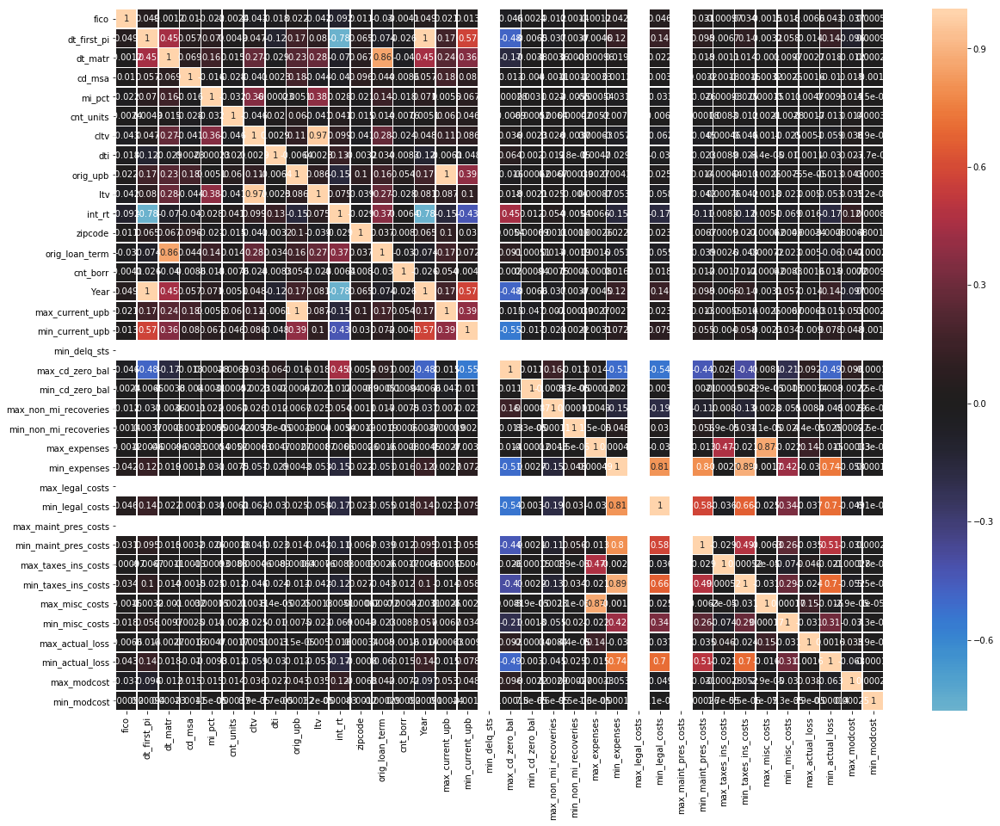

In [18]:
plt.figure(figsize=(20, 15))
sns.heatmap(joined_df.corr(), annot=True, linewidths=0.5, center=0)

In [19]:
df_789['Quarter'] = df_789.loan_seq.apply(lambda x: x[4:6])

In [20]:
df_789['Quarter'] = df_789['Quarter'] + df_789['Year'].astype(str)

In [21]:
df_789['Quarter'].unique()

array(['Q12007', 'Q22007', 'Q32007', 'Q42007', 'Q12008', 'Q22008',
       'Q32008', 'Q42008', 'Q12009', 'Q22009', 'Q32009', 'Q42009'], dtype=object)

In [22]:
df_789[(df_789['cltv']-df_789['ltv']) == 0].count()

fico                     132634
dt_first_pi              132634
flag_fthb                132634
dt_matr                  132634
cd_msa                   132634
mi_pct                   132634
cnt_units                132634
occpy_sts                132634
cltv                     132634
dti                      132634
orig_upb                 132634
ltv                      132634
int_rt                   132634
channel                  132634
ppmt_pnlty               132634
prod_type                132634
st                       132634
prop_type                132634
zipcode                  132634
id_loan                  132634
loan_purpose             132634
orig_loan_term           132634
cnt_borr                 132634
seller_name              132634
servicer_name            132634
flag_sc                  132634
Year                     132634
loan_seq                 132634
max_current_upb          132634
min_current_upb          132634
max_delq_sts             132634
min_delq

In [23]:
df_789[(df_789['cltv']-df_789['ltv']) != 0].count()

fico                     17355
dt_first_pi              17355
flag_fthb                17355
dt_matr                  17355
cd_msa                   17355
mi_pct                   17355
cnt_units                17355
occpy_sts                17355
cltv                     17355
dti                      17355
orig_upb                 17355
ltv                      17355
int_rt                   17355
channel                  17355
ppmt_pnlty               17355
prod_type                17355
st                       17355
prop_type                17355
zipcode                  17355
id_loan                  17355
loan_purpose             17355
orig_loan_term           17355
cnt_borr                 17355
seller_name              17355
servicer_name            17355
flag_sc                  17355
Year                     17355
loan_seq                 17355
max_current_upb          17355
min_current_upb          17355
max_delq_sts             17355
min_delq_sts             17355
max_cd_z

## Exploring the quarterly trends of features

**Quarterly Fico analysis**

In [33]:
df_789['fico'].groupby(df_789['Quarter']).mean()

Quarter
Q12007    730.921840
Q12008    736.084727
Q12009    762.793936
Q22007    729.270662
Q22008    745.362778
Q22009    766.450080
Q32007    726.151280
Q32008    745.153612
Q32009    760.025602
Q42007    727.503961
Q42008    758.871259
Q42009    760.073286
Name: fico, dtype: float64

In [34]:
df1= df_789['fico'].groupby(df_789['Quarter']).mean()
df1.iplot()

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



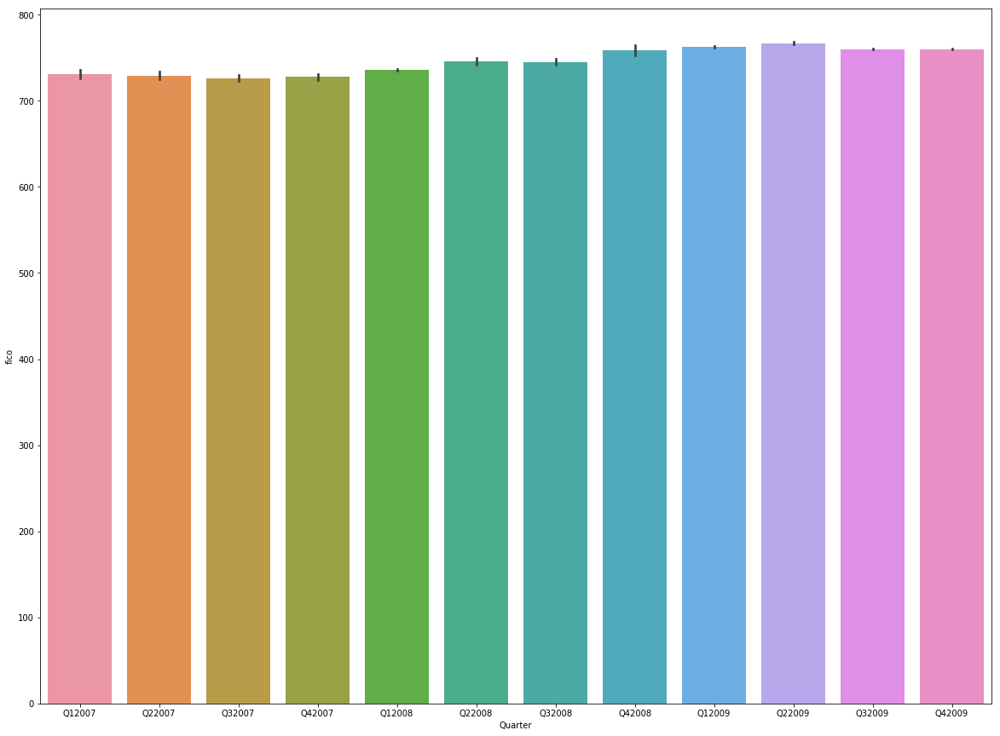

In [35]:
plt.figure(figsize=(20,15))
sns.barplot('Quarter','fico', data=df_789)

In [36]:
df_789.groupby(['Quarter']).mean()['fico'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

**Quarterly Interest Rate Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



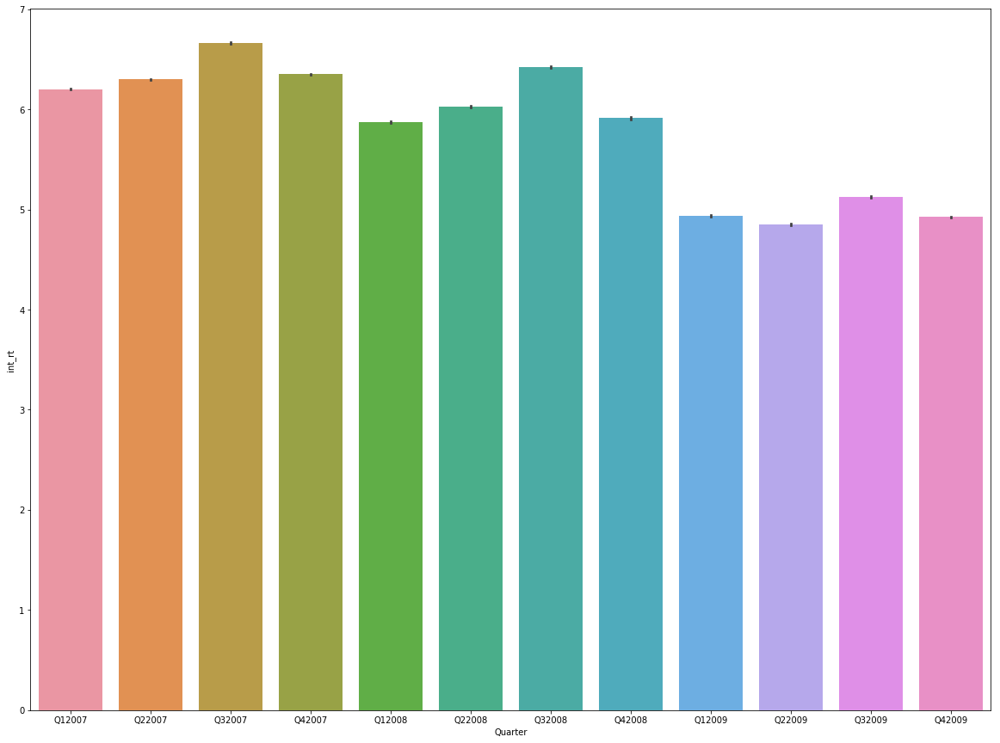

In [37]:
plt.figure(figsize=(20,15))
sns.barplot('Quarter','int_rt', data=df_789)

In [38]:
df_789.groupby(['Quarter']).max()['int_rt'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

**Quarterly UPB Analysis**

In [39]:
df_789.groupby(['Quarter']).mean()['orig_upb'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [40]:
df_789.groupby(['Quarter']).mean()['max_current_upb'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [41]:
df_789.groupby(['Quarter']).max()['orig_upb'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [42]:
df_789.groupby(['Quarter']).max()['max_current_upb'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [300]:
df_789.groupby(['Quarter']).mean()[['orig_upb','max_current_upb']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

In [43]:
df_789.groupby(['Quarter']).mean()[['orig_upb','min_current_upb']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

In [44]:
df_789.groupby(['Quarter']).mean()[['max_current_upb','min_current_upb']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

**Quarterly UPB vs Interest Rate Analysis**

In [45]:
df_789.groupby(['Quarter']).mean()[['orig_upb','int_rt']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

In [46]:
df_789.groupby(['Quarter']).mean()[['min_current_upb','int_rt']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

**Quartely Loan Analysis**

In [58]:
df_789.groupby(['Quarter']).count()['id_loan'].iplot(
   yTitle='Loan Count',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [ ]:
df_789.groupby(['Quarter'])['channel'].max().iplot(
    yTitle='Consumption in Watt-Hour',
    xTitle='Month Number',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

**Different Variables Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



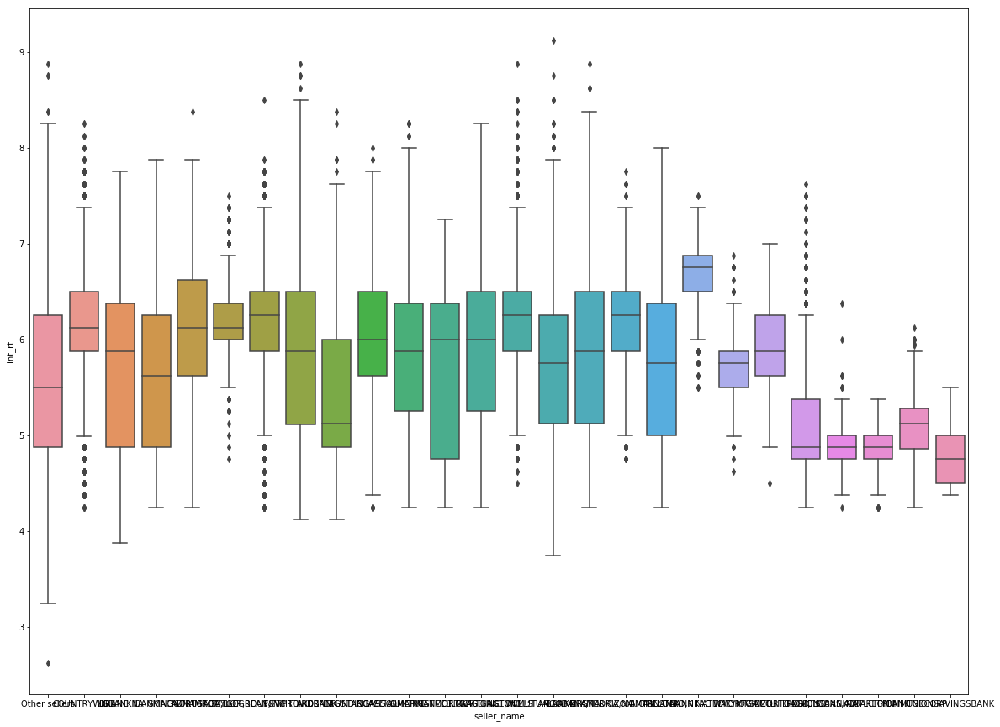

In [53]:
plt.figure(figsize=(20,15))
sns.boxplot('seller_name','int_rt', data=df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



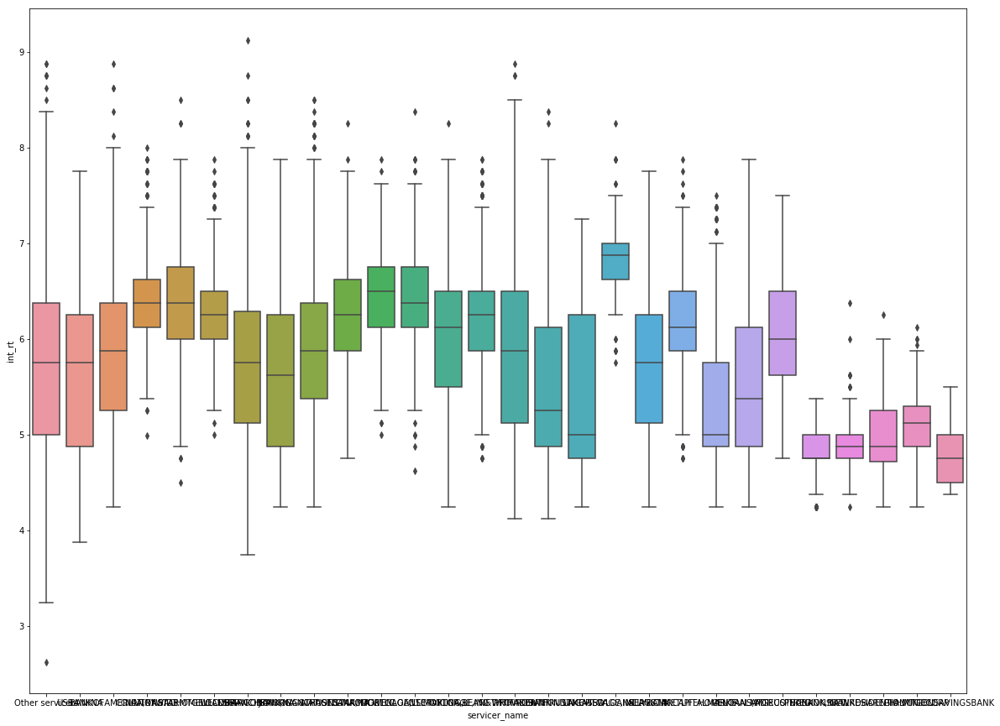

In [54]:
plt.figure(figsize=(20,15))
sns.boxplot('servicer_name','int_rt', data=df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



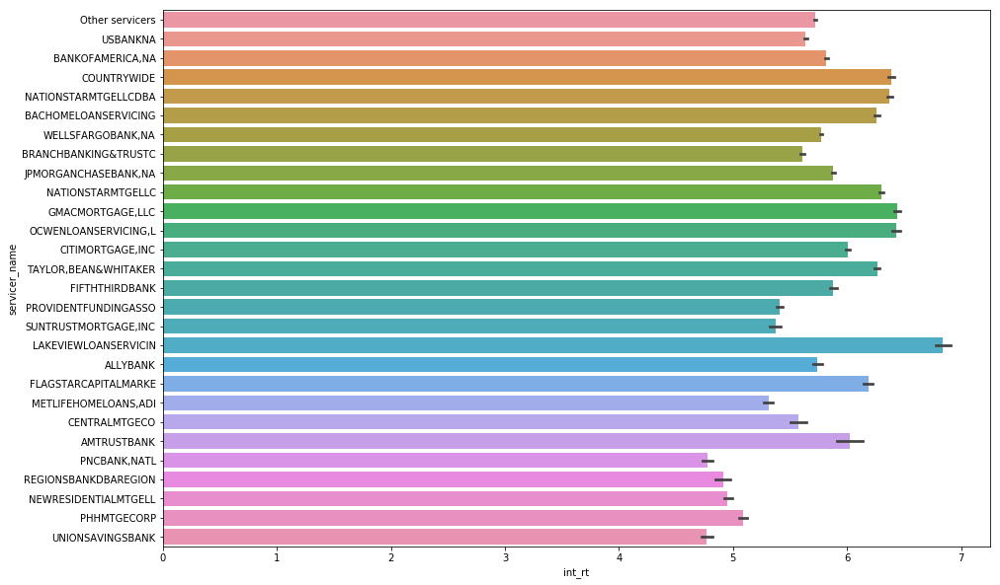

In [55]:
plt.figure(figsize=(15,10))
sns.barplot(x='int_rt', y='servicer_name',data= df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



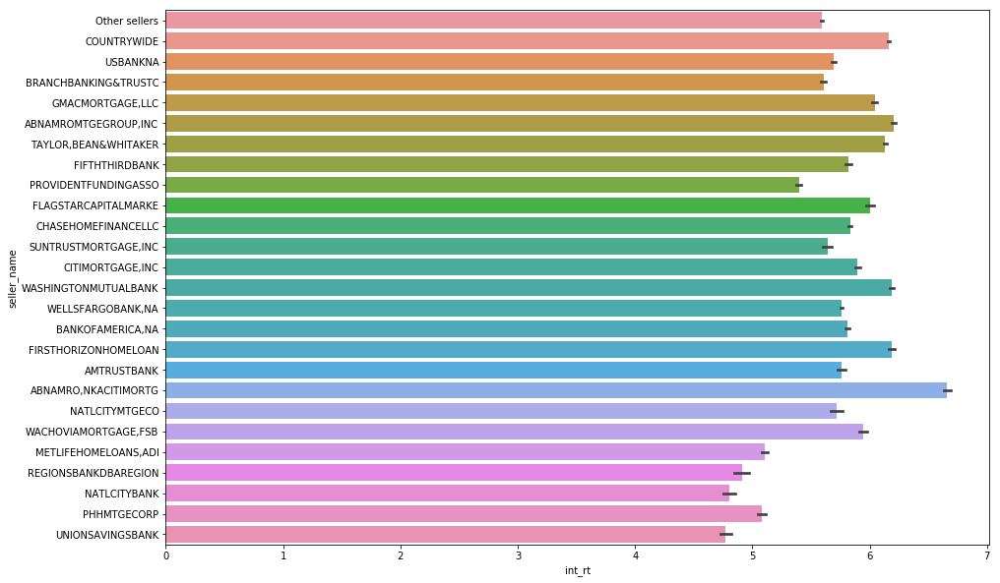

In [56]:
plt.figure(figsize=(15,10))
sns.barplot(x='int_rt', y='seller_name',data= df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



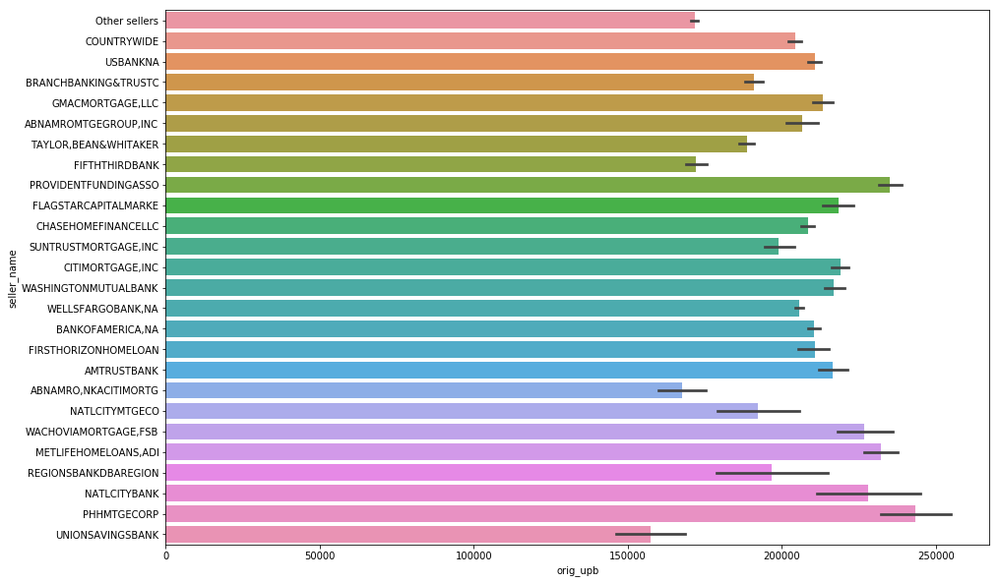

In [57]:
plt.figure(figsize=(15,10))
sns.barplot(x='orig_upb', y='seller_name',data= df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



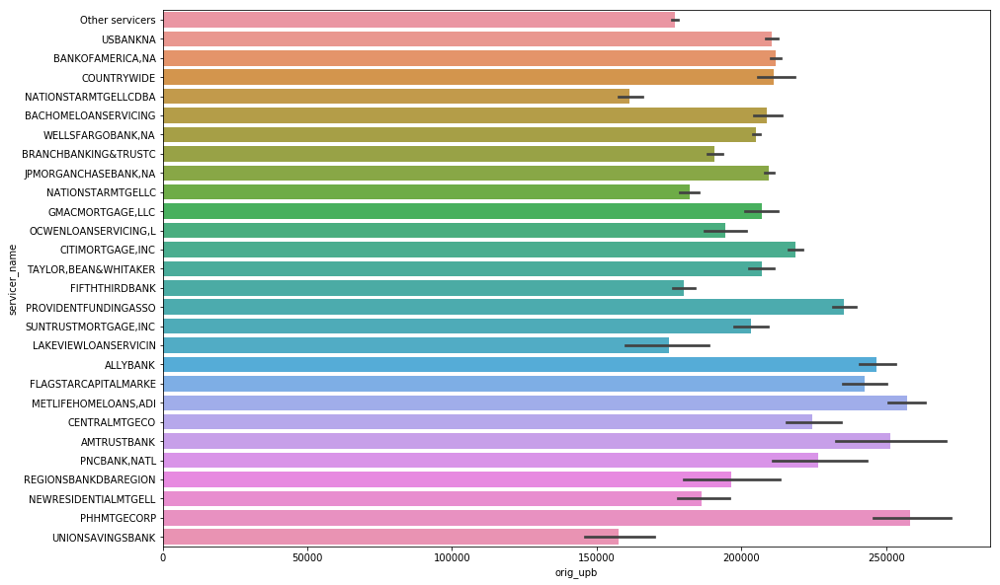

In [59]:
plt.figure(figsize=(15,10))
sns.barplot(x='orig_upb', y='servicer_name',data= df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



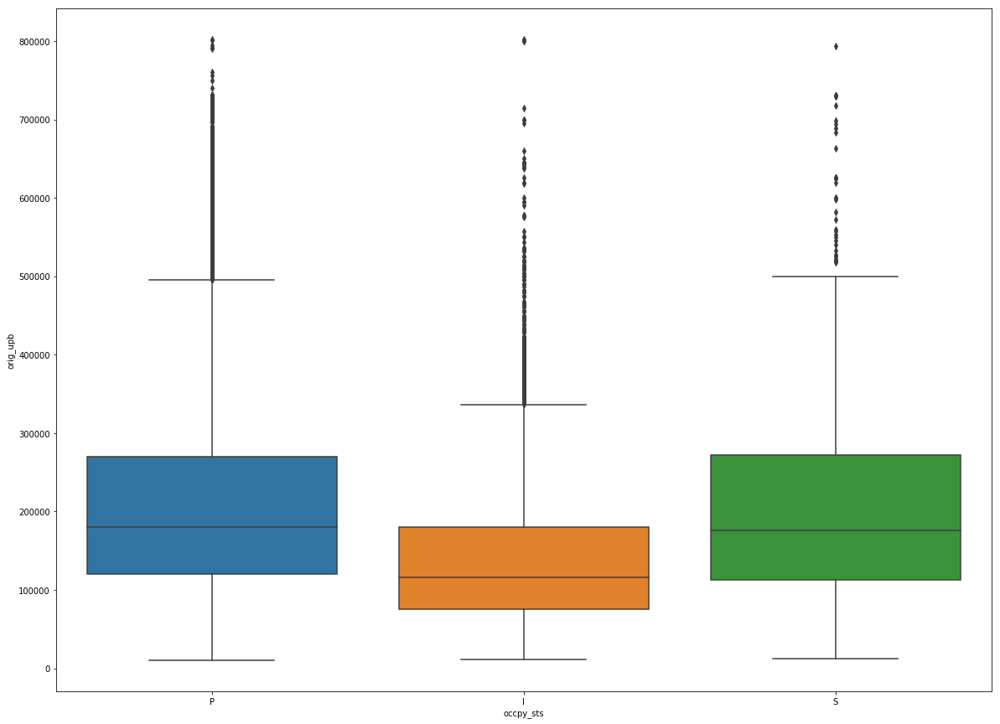

In [60]:
plt.figure(figsize=(20,15))
sns.boxplot('occpy_sts', 'orig_upb', data=df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



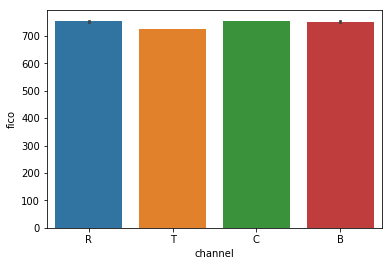

In [77]:
sns.barplot(x='channel', y='fico',data= df_789)

**Delequency Status Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



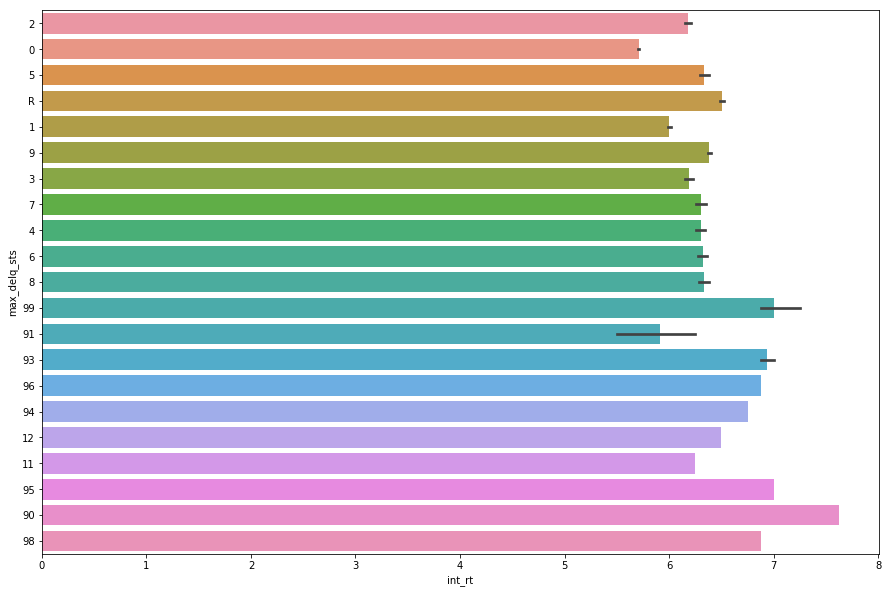

In [78]:
plt.figure(figsize=(15,10))
sns.barplot(x='int_rt', y='max_delq_sts',data= df_789)

In [62]:
df_789.groupby(['Quarter']).count()['max_delq_sts'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

In [63]:
df_789.groupby(['Quarter']).count()[['max_delq_sts','min_delq_sts']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

In [64]:
df_789[(df_789['max_delq_sts'] != 'R') & ((df_789['fico'] != 9999))].groupby(['Quarter']).max()[['max_delq_sts','fico']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

In [65]:
df_789[df_789['max_delq_sts'] != 'R'].groupby(['Quarter']).max()[['max_delq_sts','max_taxes_ins_costs']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

In [66]:
df_789[df_789['max_delq_sts'] != 'R'].groupby(['Quarter']).count()[['max_delq_sts','max_maint_pres_costs']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

In [67]:
df_789[df_789['max_delq_sts'] != 'R'].groupby(['Quarter']).max()[['max_delq_sts','max_cd_zero_bal']].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    mode='lines+markers')

In [69]:
cols = list(df_789.columns)

for col in cols :
    if col not in ['min_actual_loss','max_actual_loss','min_misc_costs','max_misc_costs','max_taxes_ins_costs',
                   'min_taxes_ins_costs','max_maint_pres_costs','min_maint_pres_costs','max_legal_costs','max_legal_costs','max_expenses','min_expenses',
                   'max_non_mi_recoveries','min_non_mi_recoveries','min_delq_sts','min_cd_zero_bal','max_modcost','min_modcost']:
        df_789[col].iplot(kind='hist',xTitle=col,yTitle='Counts')

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


**Numerical Features Analysis**

In [70]:
df_numerical= df_789.groupby('int_rt').mean()

In [71]:
df_numerical.iplot()

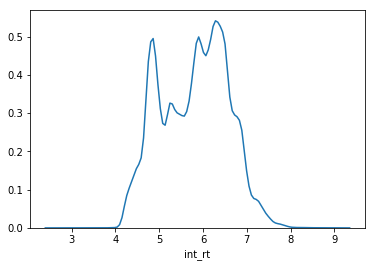

In [72]:
sns.distplot(df_789['int_rt'], hist= False)

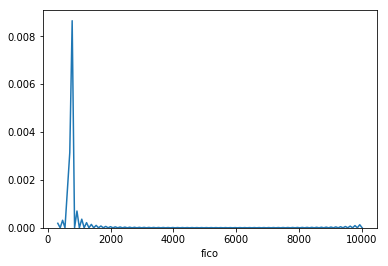

In [73]:
sns.distplot(df_789['fico'], hist= False)

**Interest Rate Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



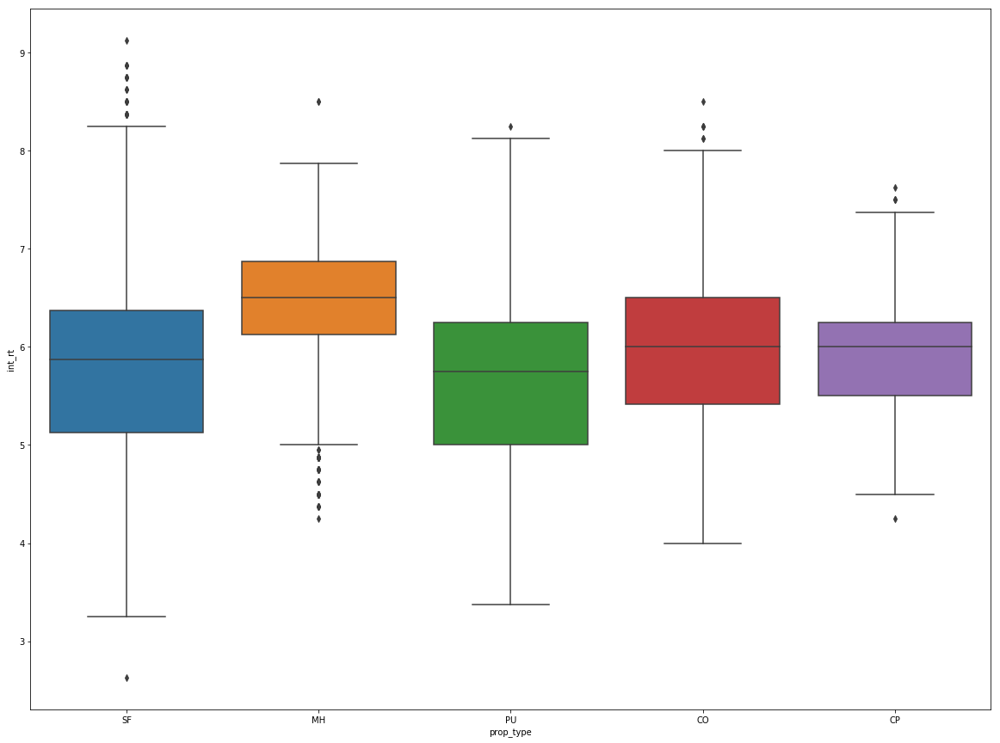

In [74]:
plt.figure(figsize=(20,15))
sns.boxplot('prop_type','int_rt', data=df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



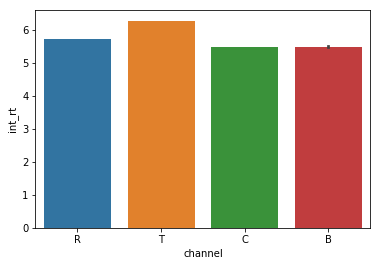

In [75]:
sns.barplot(x='channel', y='int_rt',data= df_789)

In [79]:
ubp = df_789.groupby(['int_rt']).mean()[['orig_upb','max_current_upb']]
ubp.iplot(
    yTitle='channels',
    xTitle='quarter',
    title='Month Wise Consumption in Appliances',
    mode='lines')

In [80]:
df_789.groupby('cnt_units').mean()['int_rt'].iplot(
    yTitle='cnt_units',
    xTitle='interest_rate',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [81]:
df_789.groupby(['prop_type'])['int_rt'].max().iplot(
    yTitle='Max Interest Rate',
    xTitle='State',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



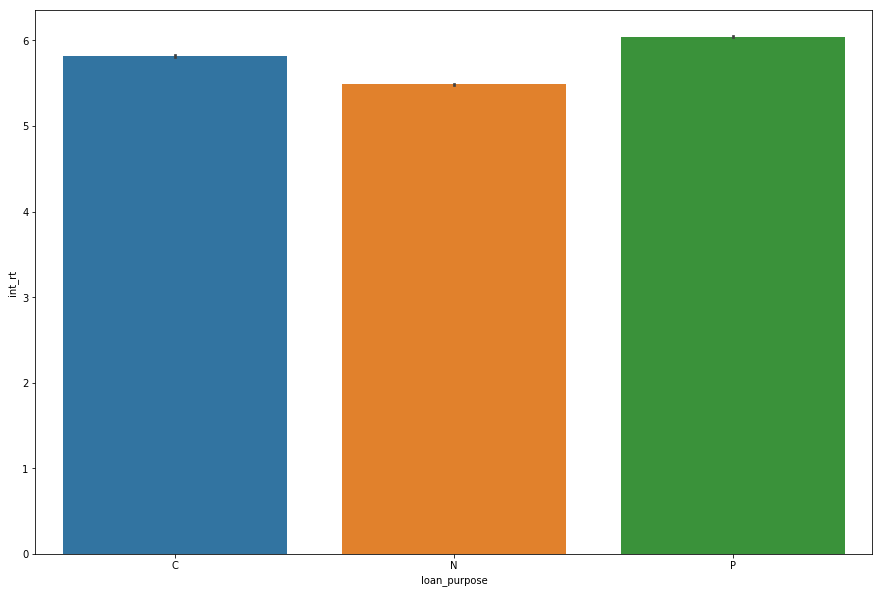

In [82]:
plt.figure(figsize=(15,10))
sns.barplot(x='loan_purpose', y='int_rt',data= df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



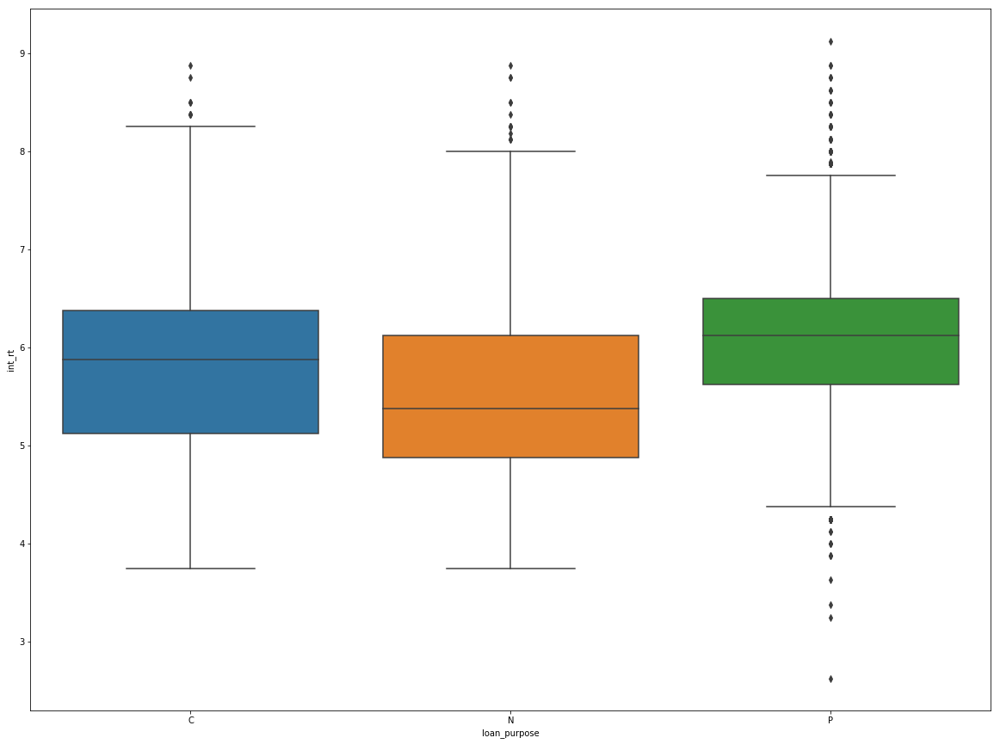

In [83]:
plt.figure(figsize=(20,15))
sns.boxplot('loan_purpose','int_rt', data=df_789)

In [84]:
df_789[df_789['loan_purpose'] != 9].groupby('loan_purpose').mean()['int_rt'].iplot(
    yTitle='Max Interest Rate',
    xTitle='State',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



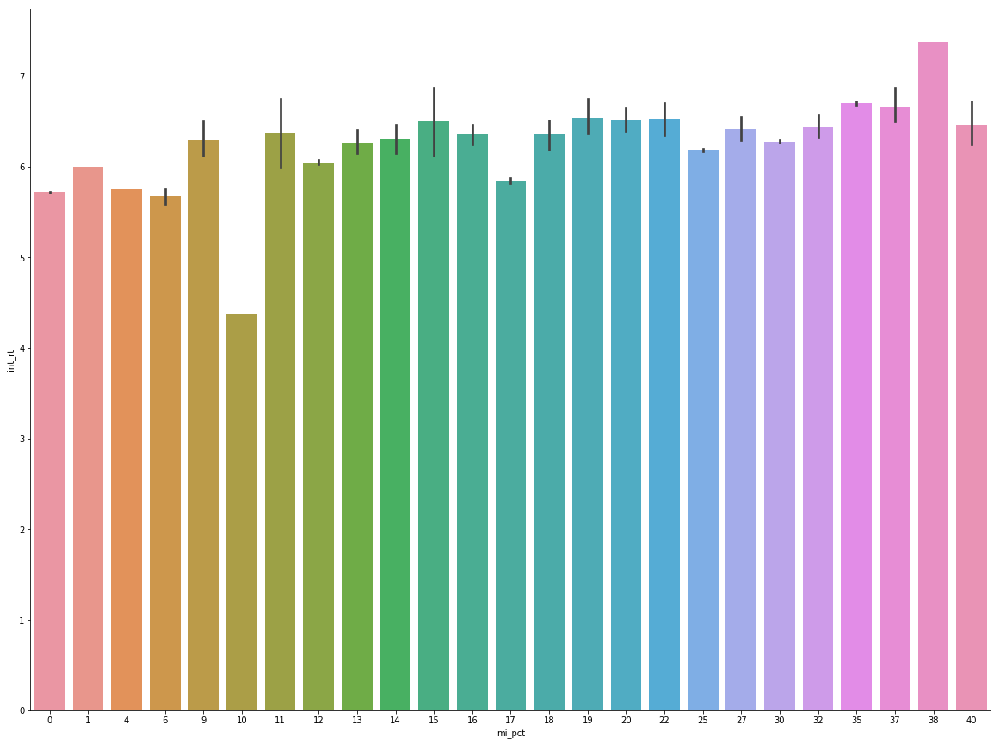

In [85]:
plt.figure(figsize=(20,15))
sns.barplot(x='mi_pct', y='int_rt',data= df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



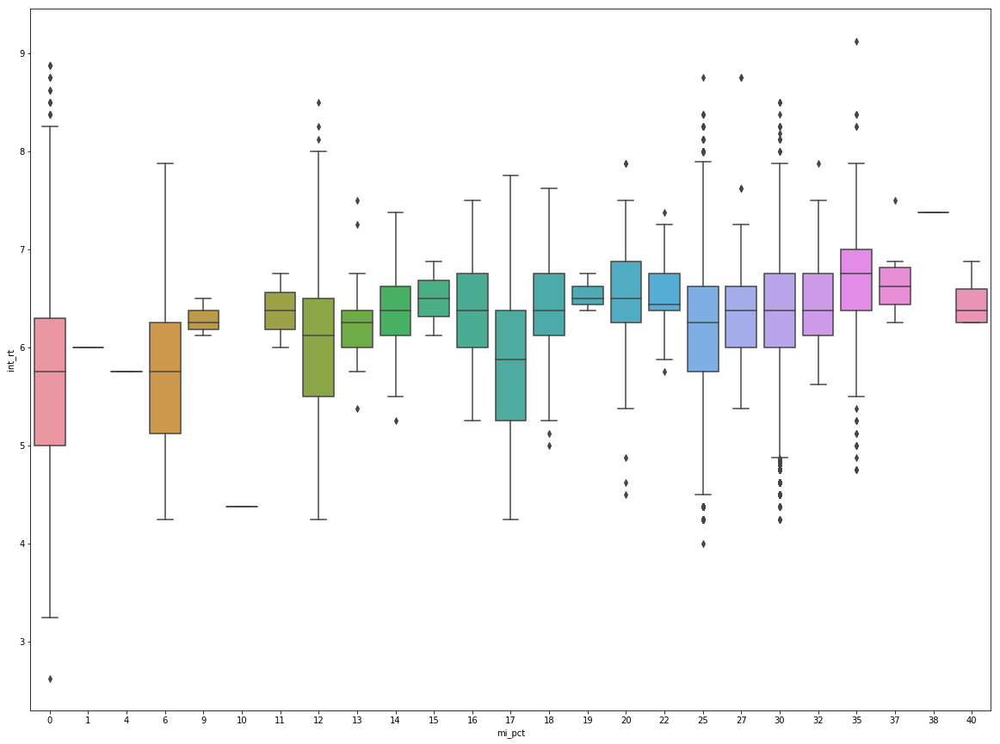

In [86]:
plt.figure(figsize=(20,15))
sns.boxplot('mi_pct','int_rt', data=df_789)

In [87]:
df_789[(df_789['mi_pct'] !=999) & (df_789['mi_pct'] != 0)].groupby('int_rt').mean()['mi_pct'].iplot(
    yTitle='MI Percentage',
    xTitle='Interest Rate ',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



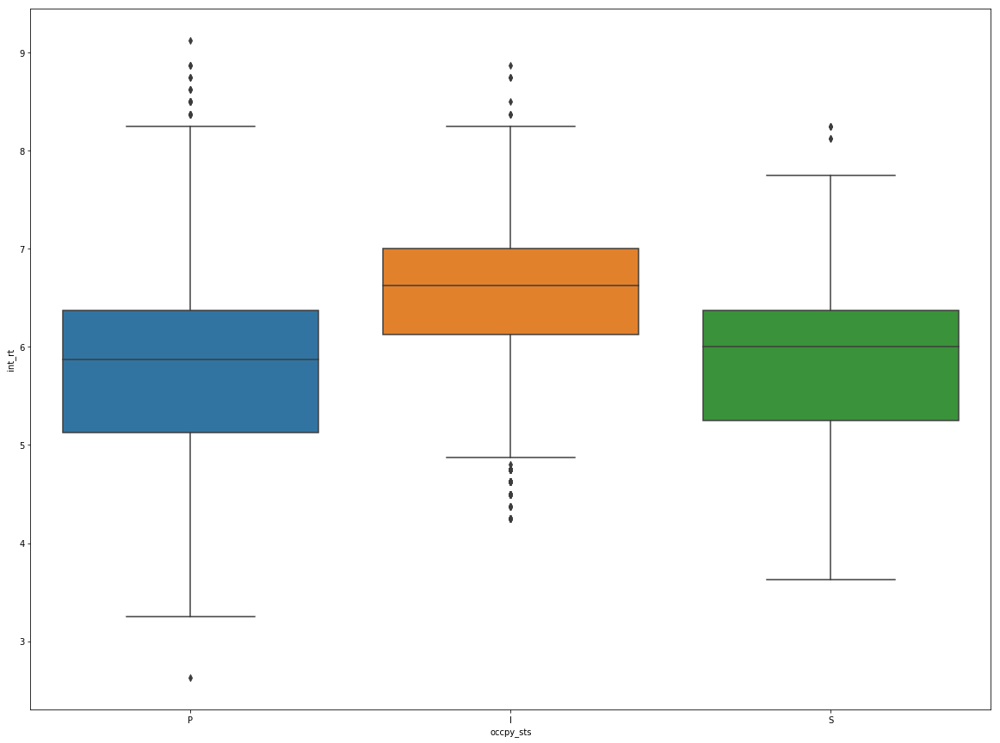

In [88]:
plt.figure(figsize=(20,15))
sns.boxplot('occpy_sts','int_rt', data=df_789)

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



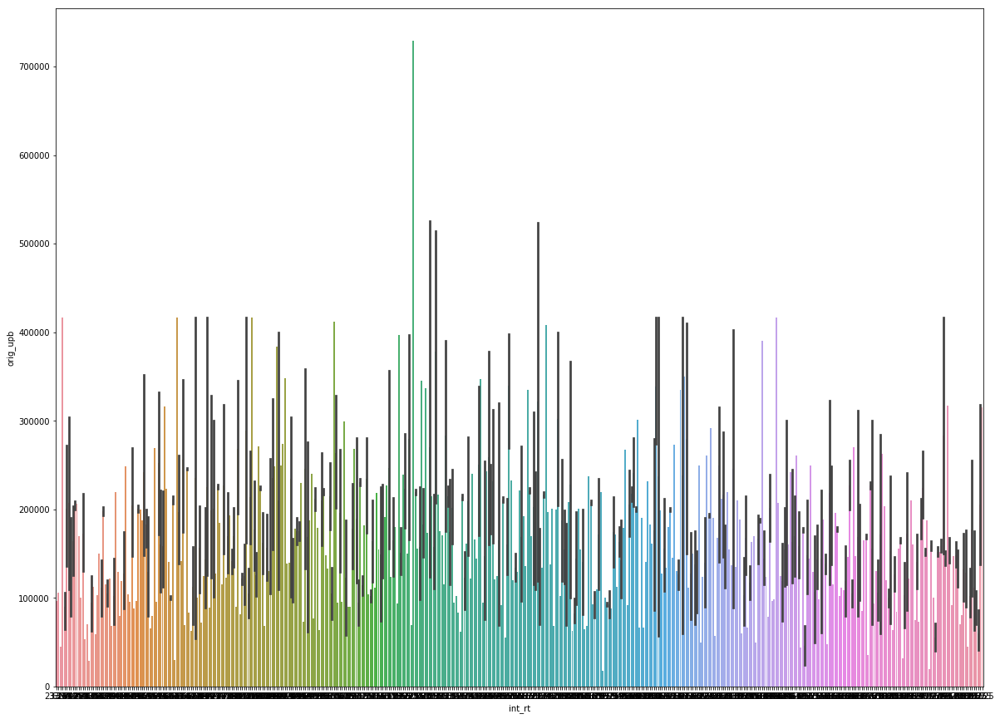

In [89]:
plt.figure(figsize=(20,15))
sns.barplot(x='int_rt', y='orig_upb',data= df_789)

**State Wise Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



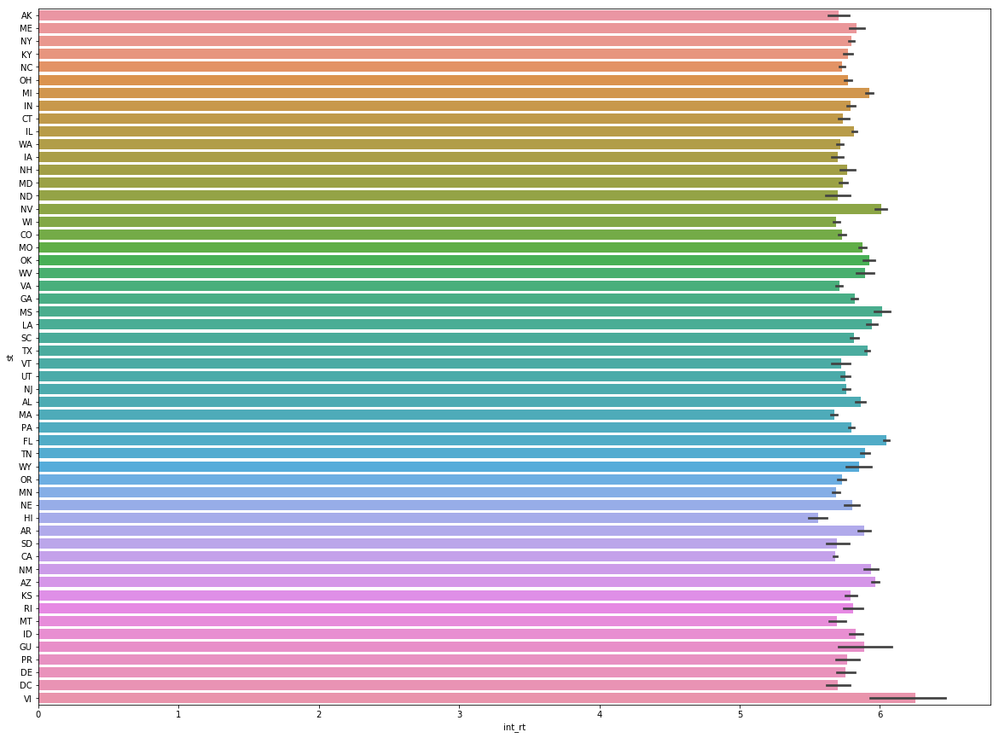

In [90]:
plt.figure(figsize=(20,15))
sns.barplot(x='int_rt', y='st',data= df_789)

In [91]:
df_789.groupby(['st'])['int_rt'].max().iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [92]:
df_789.groupby(['zipcode']).max()['int_rt'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



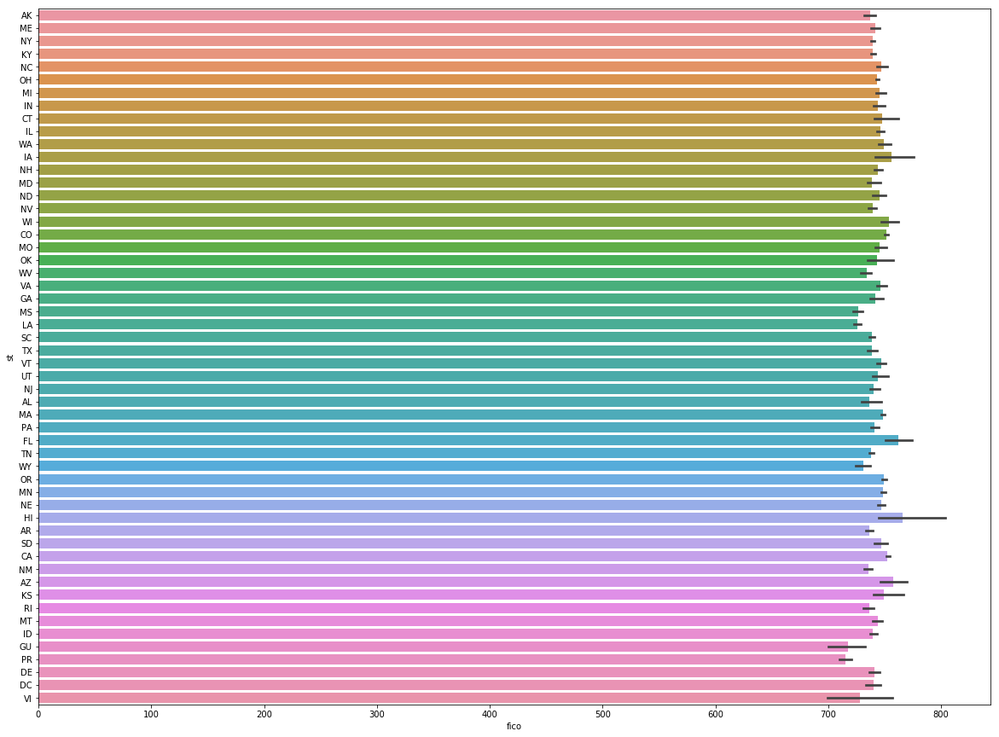

In [93]:
plt.figure(figsize=(20,15))
sns.barplot(x='fico', y='st',data= df_789)

In [94]:
df_789[df_789['fico'] != 9999].groupby('st').mean()['fico'].iplot()

In [95]:
df_789[df_789['fico'] != 9999].groupby('st').max()['fico'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



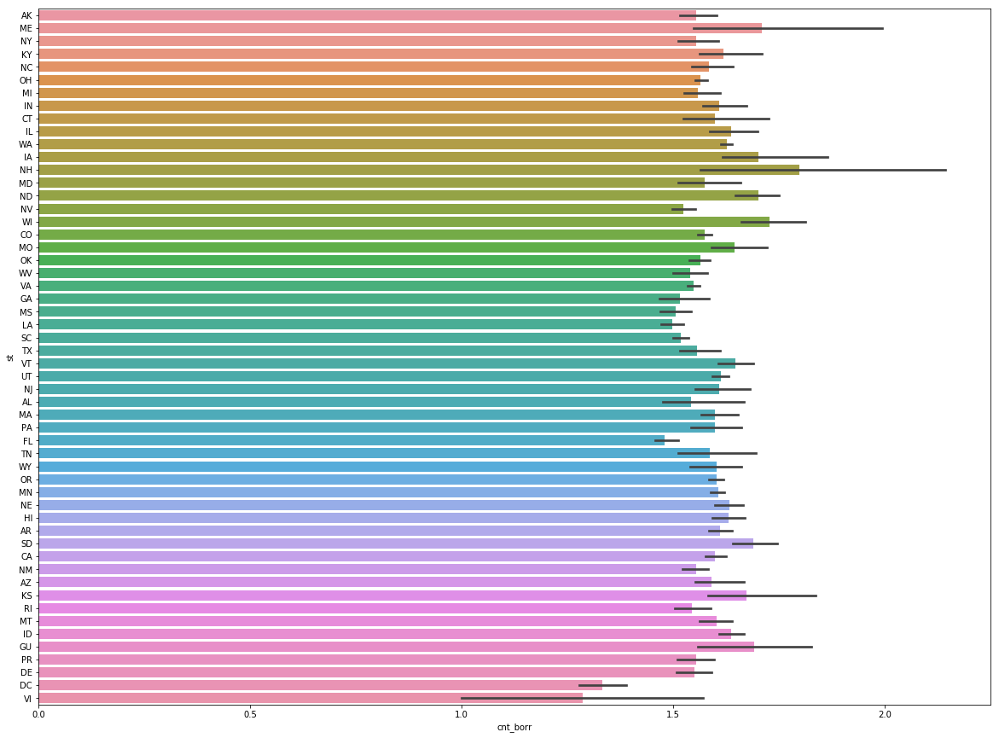

In [96]:
plt.figure(figsize=(20,15))
sns.barplot(x='cnt_borr', y='st',data= df_789)

In [97]:
df_789[df_789['cnt_borr'] != 99].groupby('st').count()['cnt_borr'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



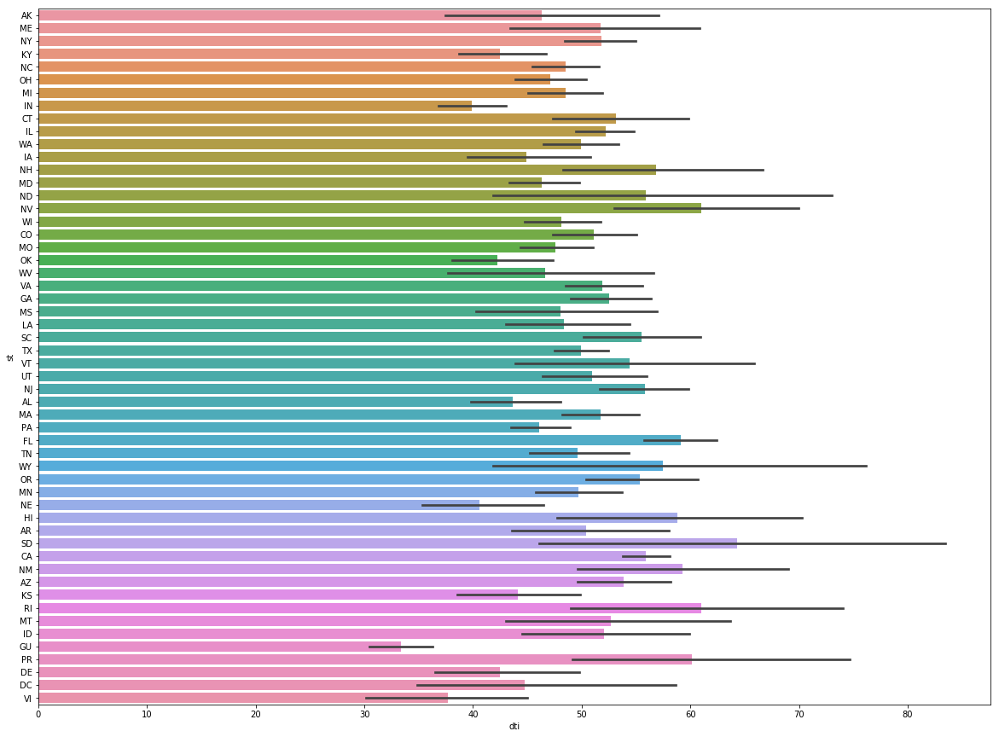

In [98]:
plt.figure(figsize=(20,15))
sns.barplot(x='dti', y='st',data= df_789)

In [99]:
df_789[(df_789['dti'] != 999) & (df_789['dti'] < 65)].groupby('st').max()['dti'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [100]:
df_789[(df_789['dti'] != 999) & (df_789['dti'] < 65)].groupby('st').mean()['dti'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



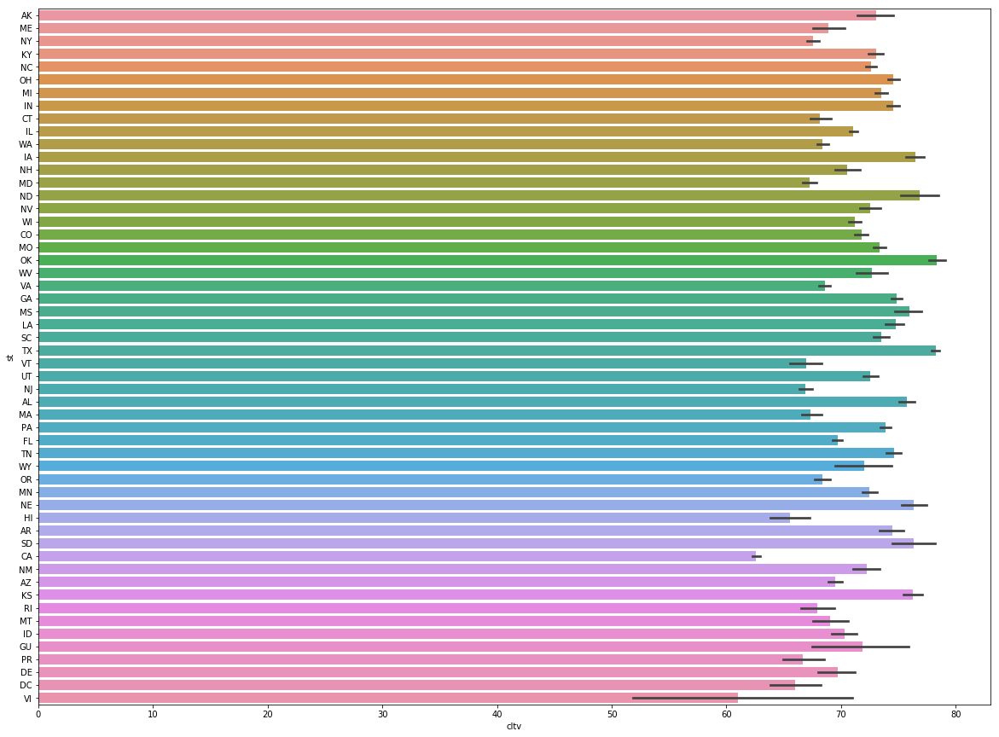

In [101]:
plt.figure(figsize=(20,15))
sns.barplot(x='cltv', y='st',data= df_789)

In [102]:
df_789[(df_789['cltv'] != 999)].groupby('st').mean()['cltv'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [103]:
df_789[(df_789['cltv'] != 999)].groupby('st').max()['cltv'].iplot(
    yTitle='Max Interest Rate',
    xTitle='Postal code',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

In [118]:
df_789[df_789['fico'] < 310]

,fico,dt_first_pi,flag_fthb,dt_matr,cd_msa,mi_pct,cnt_units,occpy_sts,cltv,dti,...,min_maint_pres_costs,max_taxes_ins_costs,min_taxes_ins_costs,max_misc_costs,min_misc_costs,max_actual_loss,min_actual_loss,max_modcost,min_modcost,Quarter


In [125]:
df_789[df_789['fico'] > 850].count()

fico                     59
dt_first_pi              59
flag_fthb                59
dt_matr                  59
cd_msa                   59
mi_pct                   59
cnt_units                59
occpy_sts                59
cltv                     59
dti                      59
orig_upb                 59
ltv                      59
int_rt                   59
channel                  59
ppmt_pnlty               59
prod_type                59
st                       59
prop_type                59
zipcode                  59
id_loan                  59
loan_purpose             59
orig_loan_term           59
cnt_borr                 59
seller_name              59
servicer_name            59
flag_sc                  59
Year                     59
loan_seq                 59
max_current_upb          59
min_current_upb          59
max_delq_sts             59
min_delq_sts             59
max_cd_zero_bal          59
min_cd_zero_bal          59
max_non_mi_recoveries    59
min_non_mi_recoverie

In [124]:
df_789[df_789['fico'] == 9999].count()

fico                     59
dt_first_pi              59
flag_fthb                59
dt_matr                  59
cd_msa                   59
mi_pct                   59
cnt_units                59
occpy_sts                59
cltv                     59
dti                      59
orig_upb                 59
ltv                      59
int_rt                   59
channel                  59
ppmt_pnlty               59
prod_type                59
st                       59
prop_type                59
zipcode                  59
id_loan                  59
loan_purpose             59
orig_loan_term           59
cnt_borr                 59
seller_name              59
servicer_name            59
flag_sc                  59
Year                     59
loan_seq                 59
max_current_upb          59
min_current_upb          59
max_delq_sts             59
min_delq_sts             59
max_cd_zero_bal          59
min_cd_zero_bal          59
max_non_mi_recoveries    59
min_non_mi_recoverie